# **TP Computer vision** - Inférence via RF-DETR

Ingé 3I - 19/02/2026

_CRUEYZE Rapaël - HAROUNYAN Natalène - PARDRINO Gabriel - ZARGOUNI Yacine_

# Importations

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install rfdetr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 4.8 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.1/168.1 kB 18.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.9/887.9 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.4/322.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.6/155.6 MB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 45.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.0/12.0 MB 60.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 kB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 49.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 217.4/217.4 kB

In [ ]:
!git clone --depth 1 -b develop https://github.com/roboflow/rf-detr.git
!cd rf-detr

Cloning into 'rf-detr'...
remote: Enumerating objects: 178, done.
remote: Counting objects: 100% (178/178), done.
remote: Compressing objects: 100% (160/160), done.
remote: Total 178 (delta 21), reused 78 (delta 9), pack-reused 0 (from 0)
Receiving objects: 100% (178/178), 247.09 KiB | 3.92 MiB/s, done.
Resolving deltas: 100% (21/21), done.


# Utilisation de RF-DETR sur roboflow

## Entrainement

1.   Load des données et entrainement
2.   Métriques d'évaluation

### Load des données et entrainement

In [ ]:
!pip install roboflow

from google.colab import userdata
from roboflow import Roboflow
rf = Roboflow(api_key=userdata.get('ROBOFLOW_API_KEY'))
project = rf.workspace("crueyzeraphal").project("fox-vs-gallinaceous")
version = project.version(2)
dataset = version.download("coco")


loading Roboflow workspace...
loading Roboflow project...


In [ ]:
from rfdetr import RFDETRNano

model = RFDETRNano()
history = []

def callback2(data):
	history.append(data)

model.callbacks["on_fit_epoch_end"].append(callback2)

model.train(dataset_dir=dataset.location, epochs=10, batch_size=32, lr=1e-4)

[2026-02-17 13:24:05] [INFO] rf-detr - Downloading pretrained weights for rf-detr-nano.pth


rf-detr-nano.pth:   0%|          | 0.00/349M [00:00<?, ?iB/s]

[2026-02-17 13:24:23] [INFO] rf-detr - MD5 validation successful for rf-detr-nano.pth


[2026-02-17 13:24:23] [WARNING] rf-detr - Using a different number of positional encodings than DINOv2, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
[2026-02-17 13:24:23] [WARNING] rf-detr - Using patch size 16 instead of 14, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.


[2026-02-17 13:24:24] [INFO] rf-detr - Loading pretrain weights


[2026-02-17 13:24:25] [WARNING] rf-detr - Reinitializing your detection head with 3 classes.


[2026-02-17 13:24:25] [INFO] rf-detr - TensorBoard logging initialized. To monitor logs, use 'tensorboard --logdir output' and open http://localhost:6006/ in browser.
[2026-02-17 13:24:25] [INFO] rf-detr - Not using distributed mode
[2026-02-17 13:24:25] [INFO] rf-detr - git:
  unknown

[2026-02-17 13:24:25] [INFO] rf-detr - Namespace(num_classes=3, grad_accum_steps=4, print_freq=10, amp=True, lr=0.0001, lr_encoder=0.00015, batch_size=32, weight_decay=0.0001, epochs=10, lr_drop=100, clip_max_norm=0.1, lr_vit_layer_decay=0.8, lr_component_decay=0.7, do_benchmark=False, dropout=0, drop_path=0.0, drop_mode='standard', drop_schedule='constant', cutoff_epoch=0, pretrained_encoder=None, pretrain_weights='rf-detr-nano.pth', pretrain_exclude_keys=None, pretrain_keys_modify_to_load=None, pretrained_distiller=None, encoder='dinov2_windowed_small', vit_encoder_num_layers=12, window_block_indexes=None, position_embedding='sine', out_feature_indexes=[3, 6, 9, 12], freeze_encoder=False, layer_norm=T

[2026-02-17 13:24:37] [INFO] rf-detr - Epoch: [0]  [0/5]  eta: 0:01:01  lr: 0.000100  class_error: 27.87  loss: 6.6236 (6.6236)  loss_ce: 0.9826 (0.9826)  loss_bbox: 0.3603 (0.3603)  loss_giou: 0.8609 (0.8609)  loss_ce_0: 0.9796 (0.9796)  loss_bbox_0: 0.3672 (0.3672)  loss_giou_0: 0.8591 (0.8591)  loss_ce_enc: 0.9785 (0.9785)  loss_bbox_enc: 0.3691 (0.3691)  loss_giou_enc: 0.8664 (0.8664)  loss_ce_unscaled: 0.9826 (0.9826)  class_error_unscaled: 27.8743 (27.8743)  loss_bbox_unscaled: 0.0721 (0.0721)  loss_giou_unscaled: 0.4305 (0.4305)  cardinality_error_unscaled: 3459.9688 (3459.9688)  loss_ce_0_unscaled: 0.9796 (0.9796)  loss_bbox_0_unscaled: 0.0734 (0.0734)  loss_giou_0_unscaled: 0.4296 (0.4296)  cardinality_error_0_unscaled: 3397.9375 (3397.9375)  loss_ce_enc_unscaled: 0.9785 (0.9785)  loss_bbox_enc_unscaled: 0.0738 (0.0738)  loss_giou_enc_unscaled: 0.4332 (0.4332)  cardinality_error_enc_unscaled: 3601.7188 (3601.7188)  time: 12.2084  data: 4.5657  max mem: 12575
[2026-02-17 13:24:

[2026-02-17 13:25:03] [INFO] rf-detr - Test:  [0/7]  eta: 0:00:13  class_error: 23.58  loss: 5.4622 (5.4622)  loss_ce: 0.9102 (0.9102)  loss_bbox: 0.2534 (0.2534)  loss_giou: 0.6348 (0.6348)  loss_ce_0: 0.9531 (0.9531)  loss_bbox_0: 0.2369 (0.2369)  loss_giou_0: 0.5984 (0.5984)  loss_ce_enc: 0.9023 (0.9023)  loss_bbox_enc: 0.2952 (0.2952)  loss_giou_enc: 0.6779 (0.6779)  loss_ce_unscaled: 0.9102 (0.9102)  class_error_unscaled: 23.5849 (23.5849)  loss_bbox_unscaled: 0.0507 (0.0507)  loss_giou_unscaled: 0.3174 (0.3174)  cardinality_error_unscaled: 75.9062 (75.9062)  loss_ce_0_unscaled: 0.9531 (0.9531)  loss_bbox_0_unscaled: 0.0474 (0.0474)  loss_giou_0_unscaled: 0.2992 (0.2992)  cardinality_error_0_unscaled: 98.9375 (98.9375)  loss_ce_enc_unscaled: 0.9023 (0.9023)  loss_bbox_enc_unscaled: 0.0590 (0.0590)  loss_giou_enc_unscaled: 0.3390 (0.3390)  cardinality_error_enc_unscaled: 154.0938 (154.0938)  time: 1.8939  data: 0.8317  max mem: 12575
[2026-02-17 13:25:06] [INFO] rf-detr - Test:  [6

### Métriques d'évaluation

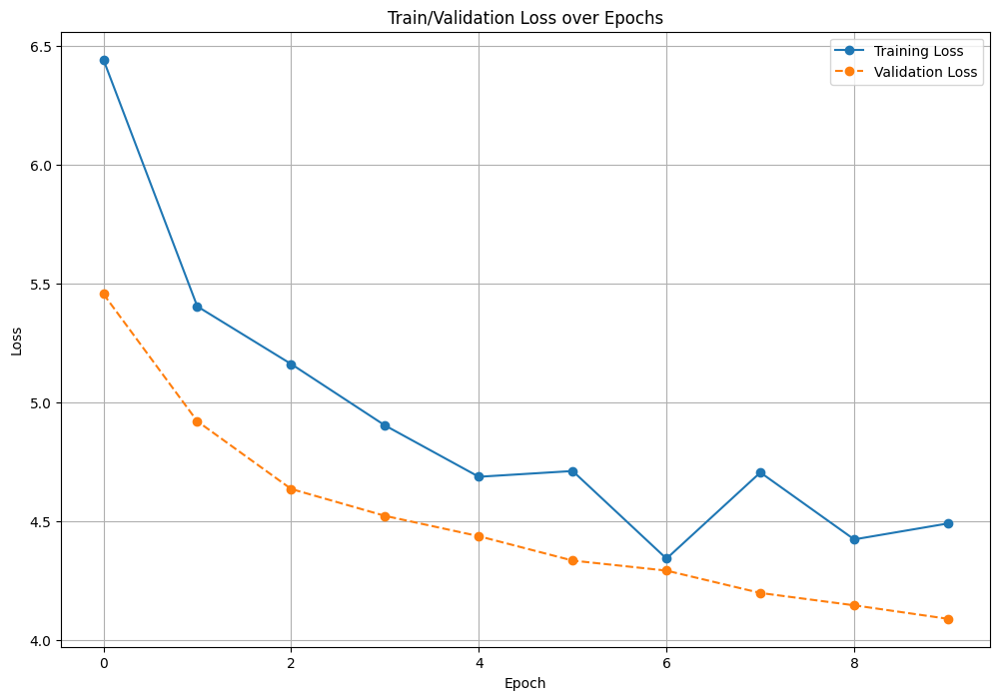

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

df = pd.DataFrame(history)

plt.figure(figsize=(12, 8))

plt.plot(
	df['epoch'],
	df['train_loss'],
	label='Training Loss',
	marker='o',
	linestyle='-'
)

plt.plot(
	df['epoch'],
	df['test_loss'],
	label='Validation Loss',
	marker='o',
	linestyle='--'
)

plt.title('Train/Validation Loss over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.show()

In [ ]:
!pip install supervision opencv-python

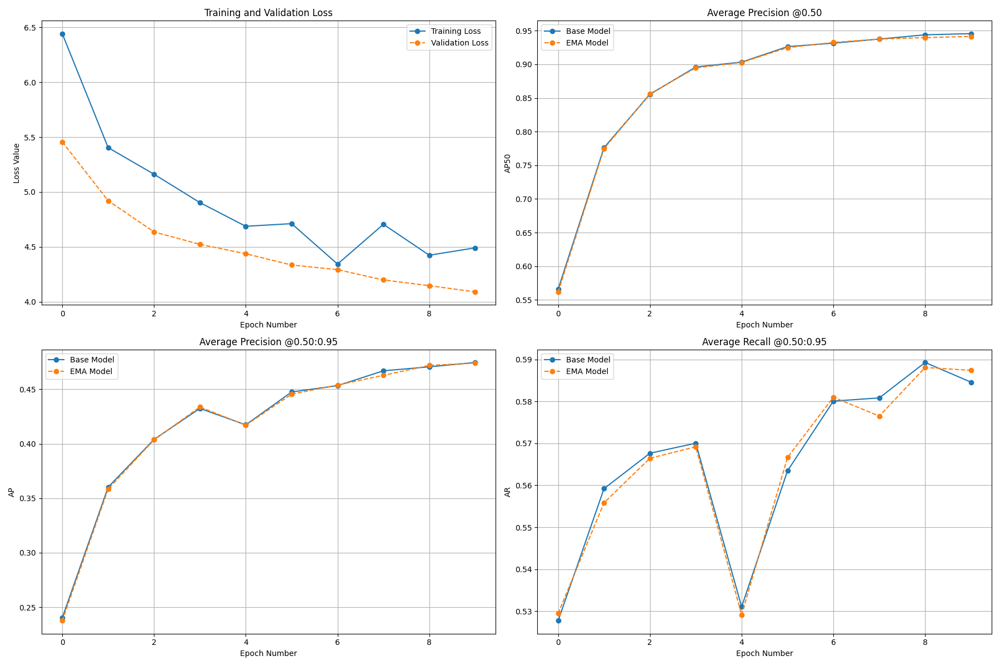

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
image =cv2.imread("/content/output/metrics_plot.png")
cv2_imshow(image)

## Données de validation

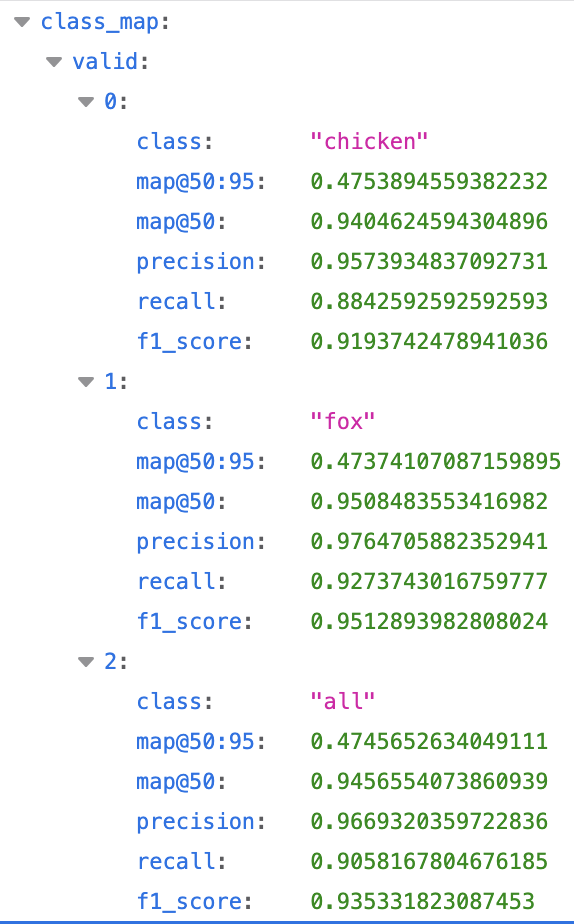

In [ ]:
import json
import cv2
import supervision as sv
from google.colab.patches import cv2_imshow


def predict_and_annotate(
    image_path: str,
    model,
    annotation_path: str,
    confidence: float = 0.5,
    show: bool = True
):
    """
    Effectue une prédiction sur une image et retourne l'image annotée.

    Args:
        image_path (str): chemin vers l'image
        model: modèle avec méthode .predict()
        annotation_path (str): chemin vers le fichier _annotations.coco.json
        confidence (float): seuil de confiance
        show (bool): afficher l'image annotée

    Returns:
        annotated_image (np.ndarray)
        detections
    """

    # Charger les classes
    with open(annotation_path) as f:
        coco = json.load(f)

    id2label = {cat["id"]: cat["name"] for cat in coco["categories"]}

    # Charger image
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)

    if image is None:
        raise ValueError(f"Impossible de charger l'image : {image_path}")

    # Gérer PNG avec alpha
    if len(image.shape) == 3 and image.shape[2] == 4:
        image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)

    # Prédiction
    detections = model.predict(image, confidence=confidence)

    # Annotateurs
    box_annotator = sv.BoxAnnotator()
    label_annotator = sv.LabelAnnotator()

    labels = [
        f"{id2label.get(class_id, 'unknown')} {conf:.2f}"
        for class_id, conf
        in zip(detections.class_id, detections.confidence)
    ]

    annotated = box_annotator.annotate(scene=image, detections=detections)
    annotated = label_annotator.annotate(
        scene=annotated,
        detections=detections,
        labels=labels
    )

    if show:
        cv2_imshow(annotated)

    return


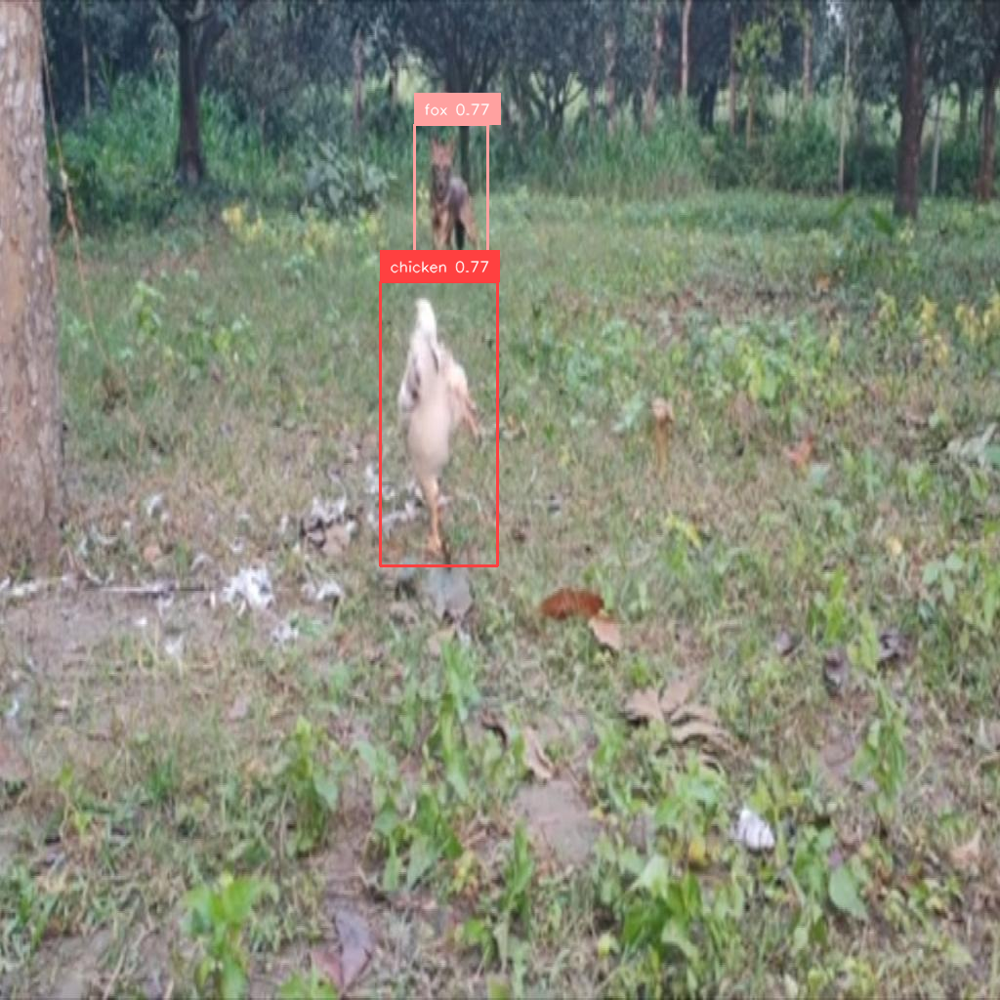

In [ ]:
predict_and_annotate(image_path="/content/fox-VS-gallinaceous-2/valid/13t_mp4-0065_jpg.rf.44983afddc18b551f5b2cba91c52e676.jpg",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")

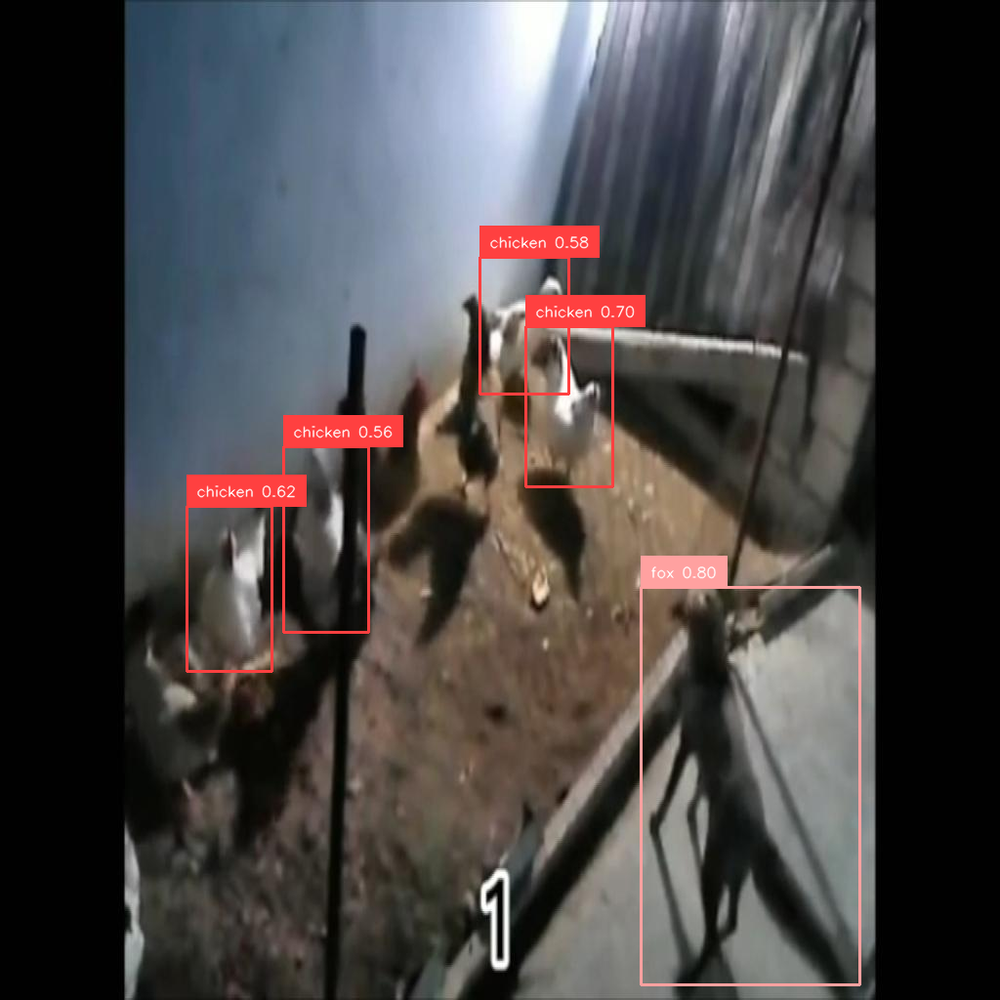

In [ ]:
predict_and_annotate(image_path="/content/fox-VS-gallinaceous-2/valid/7t_mp4-0014_jpg.rf.2a79753d9ff0a75b1a1beae617c95c1c.jpg",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")

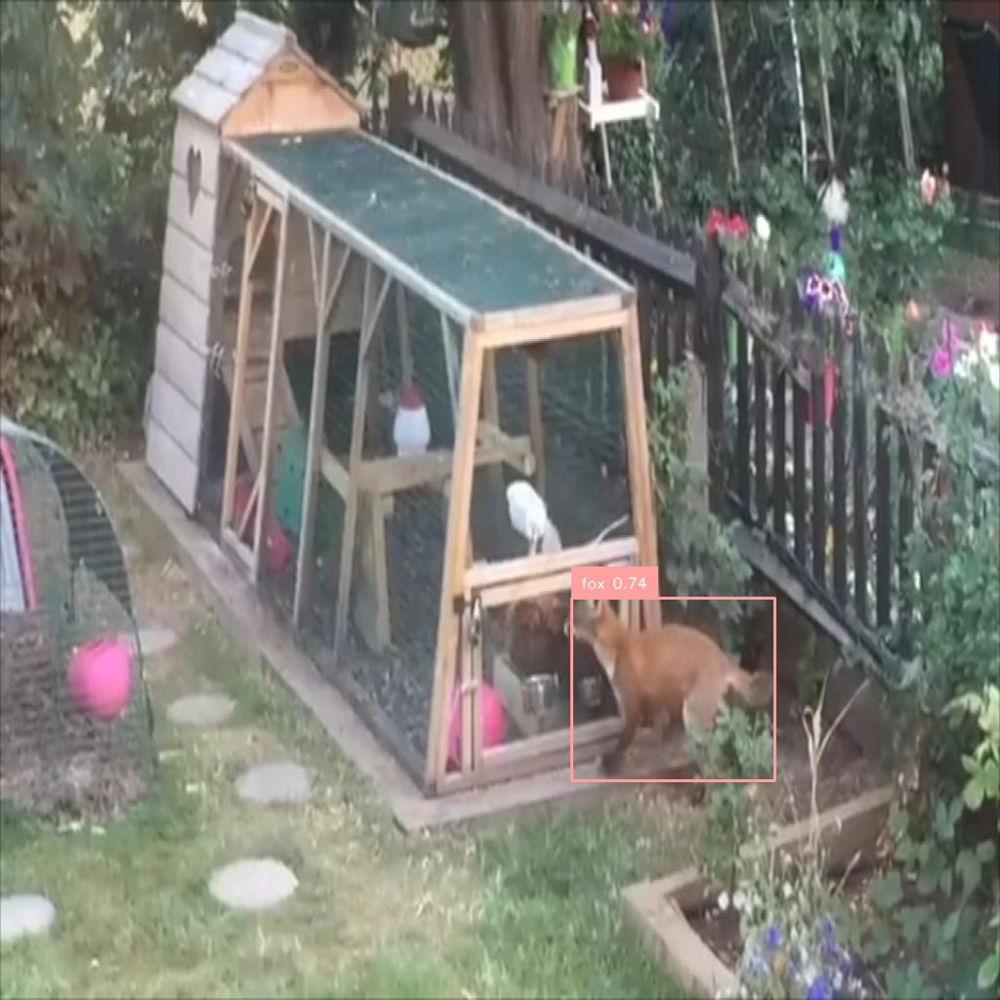

In [ ]:
predict_and_annotate(image_path="/content/fox-VS-gallinaceous-2/valid/9t_mp4-0020_jpg.rf.6789b29befa272a33dea6b8285ae66c6.jpg",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")

## Utilisation du modèle sur des images de test

1.   Test sur l'ensemble de test du dataset
2.   Test sur des images hors dataset


### Test sur l'ensemble de test du dataset

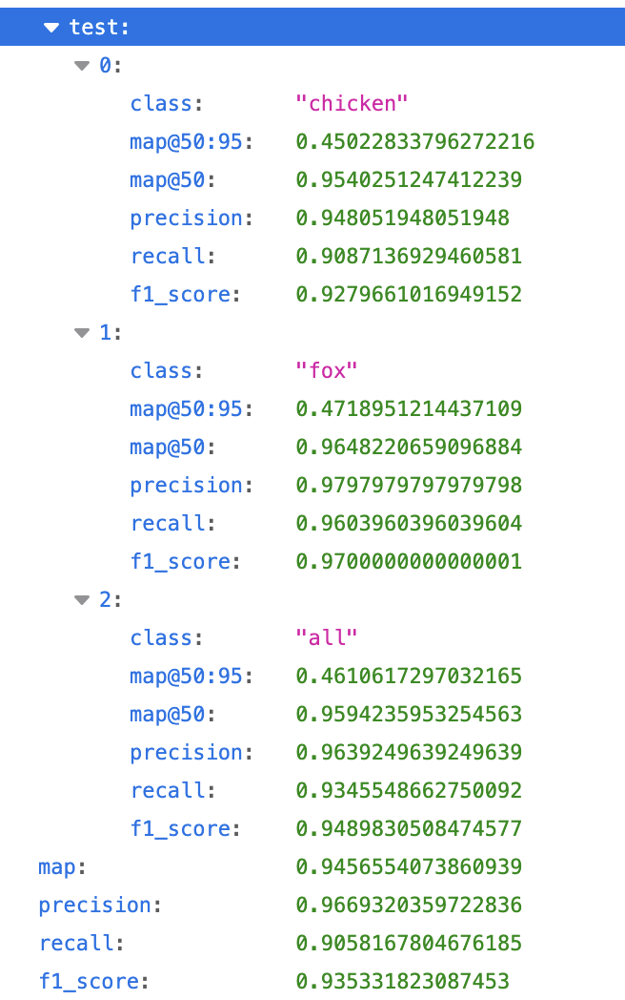

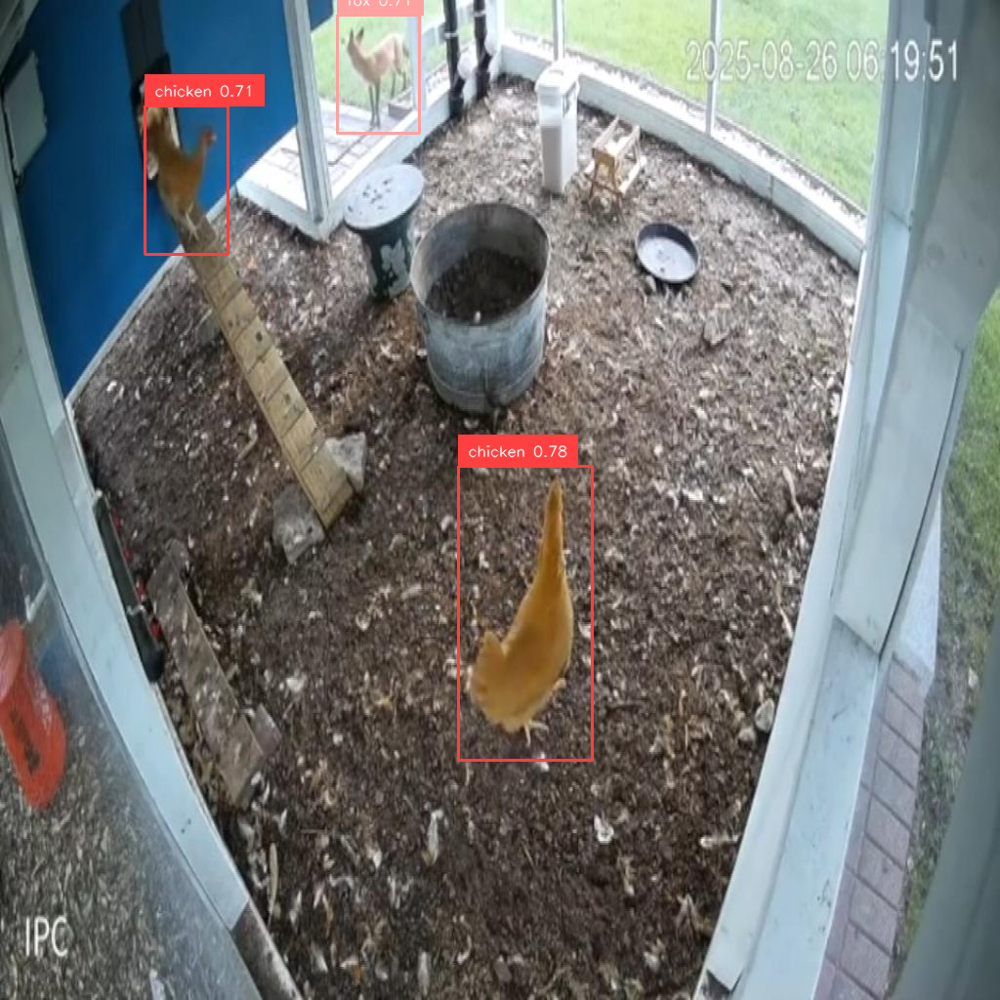

In [ ]:
predict_and_annotate(image_path="/content/fox-VS-gallinaceous-2/test/3t_mp4-0017_jpg.rf.3d423fdd06e78416394c89e301c78eb5.jpg",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")

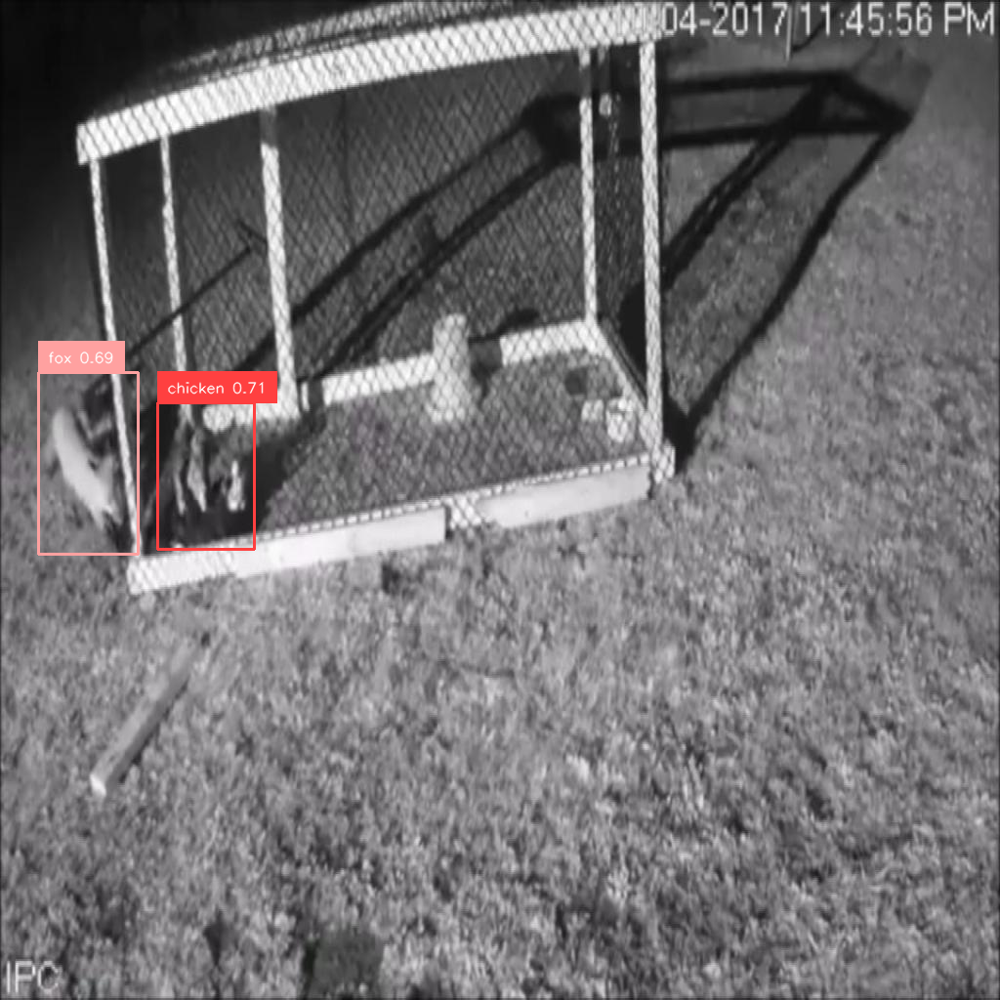

In [ ]:
predict_and_annotate(image_path="/content/fox-VS-gallinaceous-2/test/6t_mp4-0028_jpg.rf.74fed921209e9b7d932a2738efafc6cf.jpg",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")

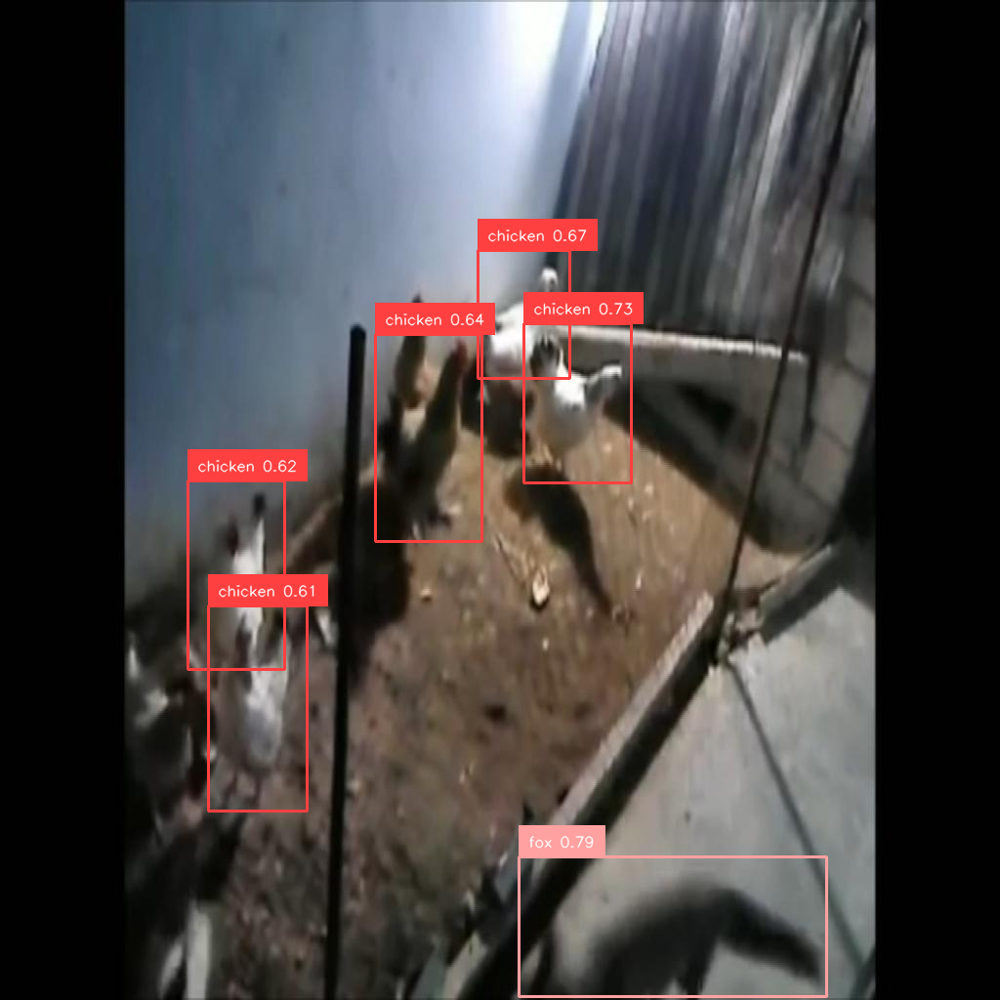

In [ ]:
predict_and_annotate(image_path="/content/fox-VS-gallinaceous-2/test/7t_mp4-0030_jpg.rf.60c7395795074c910b5b495cb0078504.jpg",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")

### Test sur des images hors dataset

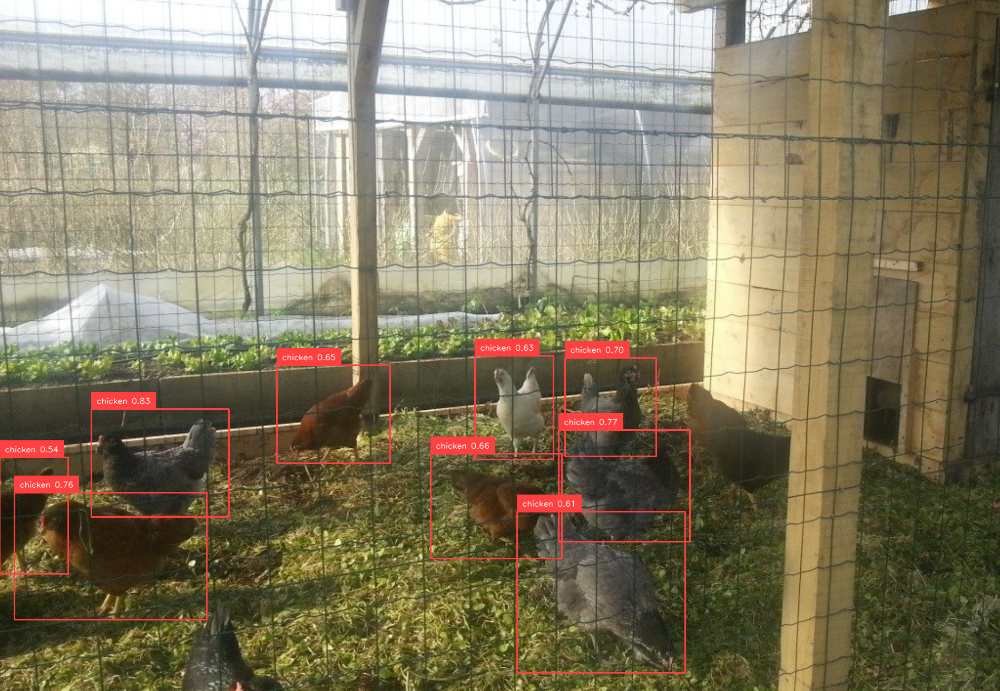

In [ ]:
predict_and_annotate(image_path="/content/drive/MyDrive/Images_test/Poules_Multiple.png",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")


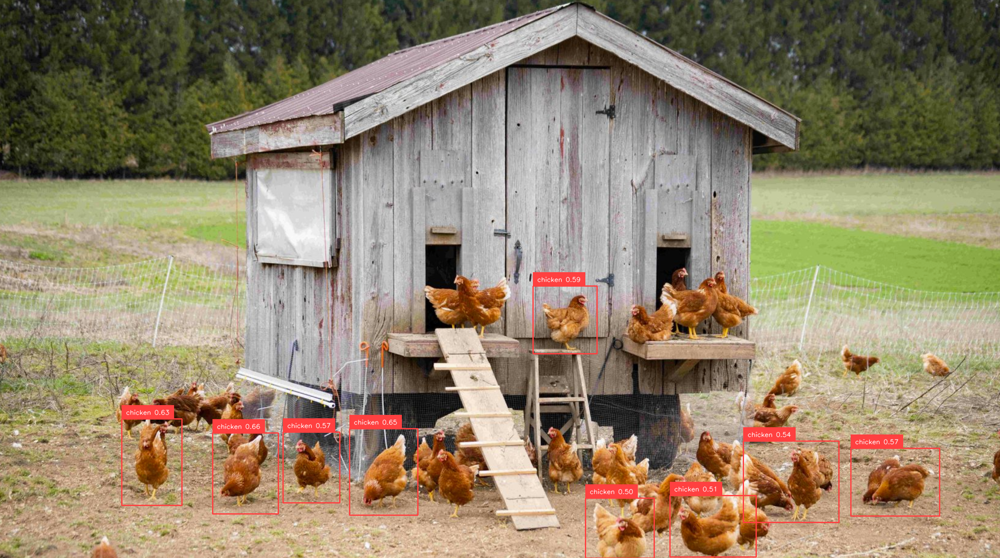

In [ ]:
predict_and_annotate(image_path="/content/drive/MyDrive/Images_test/Poules_Nombreuses.png",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")


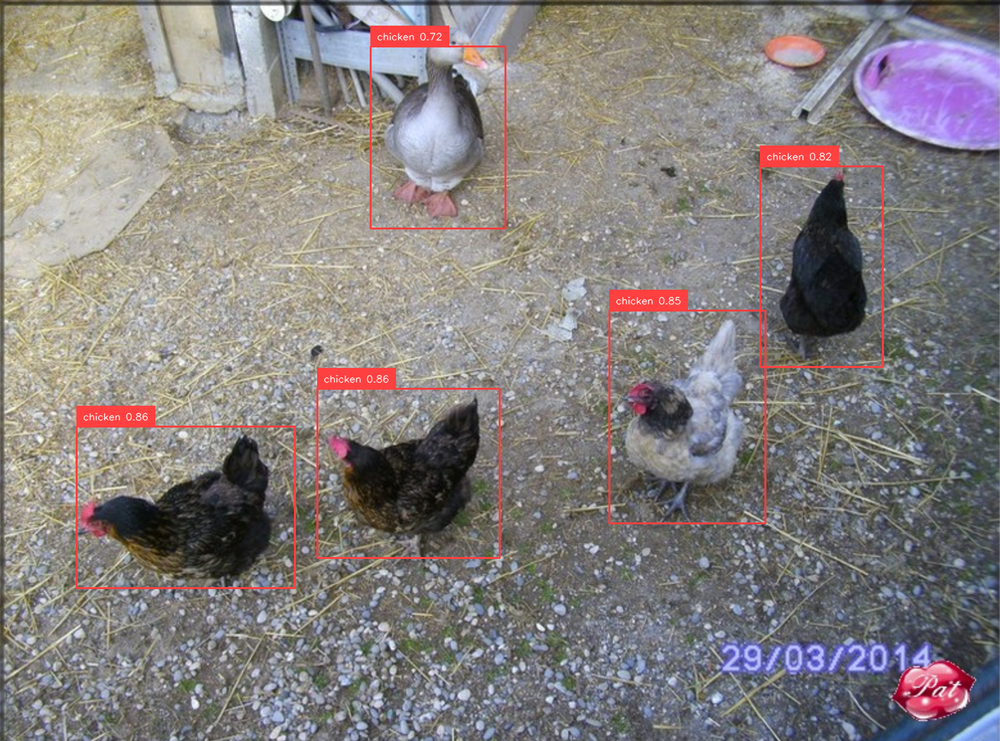

In [ ]:
predict_and_annotate(image_path="/content/drive/MyDrive/Images_test/Poules_Oies.png",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")


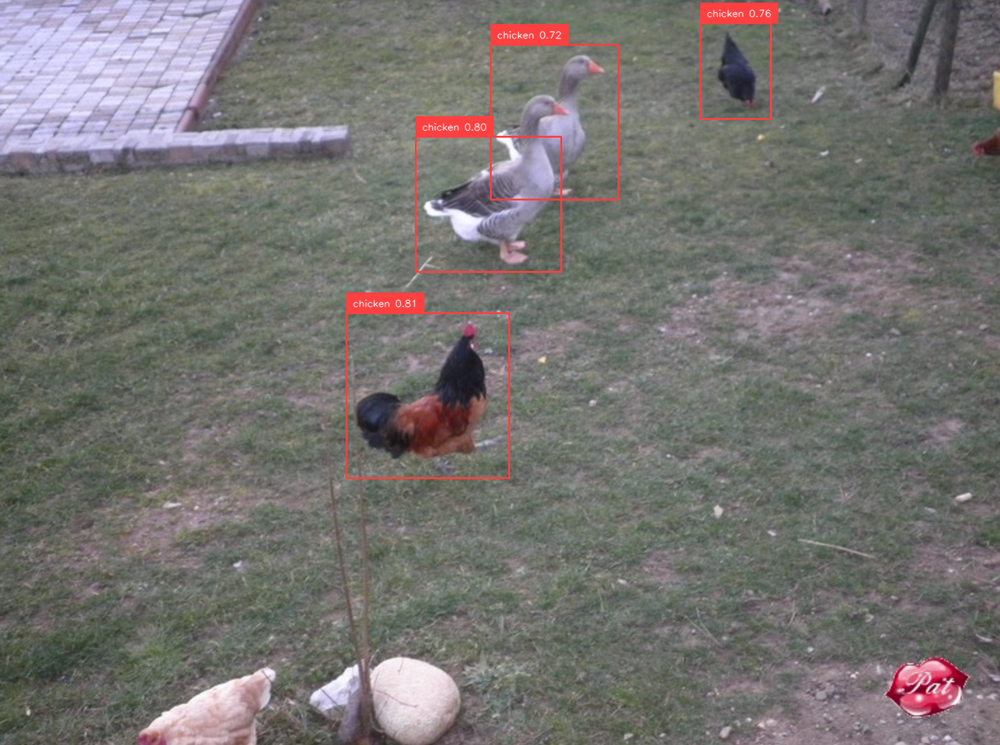

In [ ]:
predict_and_annotate(image_path="/content/drive/MyDrive/Images_test/Poules_Oies_2.png",model=model,annotation_path="/content/fox-VS-gallinaceous-2/valid/_annotations.coco.json")
